In [1]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import Sequence , get_file
from tensorflow.keras.callbacks import ModelCheckpoint, LearningRateScheduler ,EarlyStopping
from tensorflow.keras import layers
from tensorflow import keras
import tensorflow as tf


import matplotlib.pyplot as plt
import numpy as np
import cv2
import os, json, shutil
import os
import json
import sys
from datetime import datetime
import os
import time
from itertools import islice

import segmentation_models as sm
sm.set_framework('tf.keras')


# gpus = tf.config.list_physical_devices('GPU')
# if gpus:
#     try:
#         tf.config.experimental.set_visible_devices(gpus[0], 'GPU')
#         logical_gpus = tf.config.experimental.list_logical_devices('GPU')
#         print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPU")    
#     except RuntimeError as e:
#         # Visible devices must be set before GPUs have been initialized
#         print(e)
    
# tf.config.set_soft_device_placement(True)

mirrored_strategy = tf.distribute.MirroredStrategy()


class DataGenerator(Sequence):
    def __init__(self, list_IDs,label_map , img_dir ,mode):
        'Initialization'
        self.list_IDs = list_IDs
        self.label_map = image_label_map
        self.on_epoch_end()
        self.img_dir = img_dir + "/images"
        self.mask_dir = img_dir + "/masks"
        self.mode = mode

    def __len__(self):
        return int(len(self.list_IDs))

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))    

    
    def __getitem__(self, index):
        'Generate one batch of data'
        indexes = self.indexes[index:(index+1)]
        # Find list of IDs
        list_IDs_temp = [self.list_IDs[k] for k in indexes]
        # Generate data
        X, y = self.__data_generation(list_IDs_temp)
        return X, y
    
    
    def __data_generation(self, list_IDs_temp):
        """Generates data containing batch_size samples"""
        if self.mode == "train":
            # Generate data
            X, y = self.load_file(list_IDs_temp)
            return X, y
        elif self.mode == "val":
            X, y = self.load_file(list_IDs_temp)
            return X, y
        
        
    def load_file(self, id_list):
        list_IDs_temp = id_list
        for ID in list_IDs_temp:
            x_file_path = os.path.join(self.img_dir, ID)
            y_file_path = os.path.join(self.mask_dir, self.label_map.get(ID))
            # Store sample
            X = np.load(x_file_path)
            # Store class
            y = np.load(y_file_path).astype('float32')
        return X, y    
    

    
    
out_train_data_dir = '/glade/scratch/hgamarro/Deep_learning/HG_space/data/processed/Vegas_v1/train'
out_val_data_dir = '/glade/scratch/hgamarro/Deep_learning/HG_space/data/processed/Vegas_v1/val'

out_test_data_dir = '/glade/scratch/hgamarro/Deep_learning/HG_space/data/processed/Vegas_v1/test'


# ====================
# train set
# ====================
all_files = [s for s in os.listdir(out_train_data_dir + "/images/") if s.endswith('.npy')]
all_files.append([s for s in os.listdir(out_train_data_dir + "/masks/") if s.endswith('.npy')] )

image_label_map = {
        "image_file_{}.npy".format(i+1): "label_file_{}.npy".format(i+1)
        for i in range(int(len(all_files)))}
partition = [item for item in all_files if "image_file" in item]

# ====================
# validation set
# ====================

all_val_files = [s for s in os.listdir(out_val_data_dir + "/images/") if s.endswith('.npy')]
all_val_files.append([s for s in os.listdir(out_val_data_dir + "/masks/") if s.endswith('.npy')] )
val_image_label_map = {
        "image_file_{}.npy".format(i+1): "label_file_{}.npy".format(i+1)
        for i in range(int(len(all_val_files)))}
val_partition = [item for item in all_val_files if "image_file" in item]


train_generator = DataGenerator(partition,image_label_map,out_train_data_dir, "train")
val_generator= DataGenerator(val_partition,val_image_label_map,out_val_data_dir, "val")

Segmentation Models: using `tf.keras` framework.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1', '/job:localhost/replica:0/task:0/device:GPU:2', '/job:localhost/replica:0/task:0/device:GPU:3')


In [2]:
# ====================
# test set
# ====================

all_test_files = [s for s in os.listdir(out_test_data_dir + "/images/") if s.endswith('.npy')]
all_test_files.append([s for s in os.listdir(out_test_data_dir + "/masks/") if s.endswith('.npy')] )
test_image_label_map = {
        "image_file_{}.npy".format(i+1): "label_file_{}.npy".format(i+1)
        for i in range(int(len(all_test_files)))}
test_partition = [item for item in all_test_files if "image_file" in item]

test_generator= DataGenerator(test_partition,test_image_label_map,out_test_data_dir, "val")

In [3]:
def plot_history(history):
       
    acc = history.history['iou_score']
    val_acc = history.history['val_iou_score']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    
    plt.figure(figsize=(10, 5),dpi=360)
    plt.subplot(1, 2, 1)
    plt.plot(acc)
    plt.plot(val_acc)
    plt.ylabel('iou_score')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    
    plt.subplot(1, 2, 2)
    plt.plot(loss)
    plt.plot(val_loss)
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    return plt

In [4]:
save_path = "/glade/scratch/hgamarro/Deep_learning/HG_space/models/scratch/BD_v1_results_main/"

In [48]:
tf.keras.backend.clear_session()

BACKBONE = 'vgg16'
# BACKBONE = 'resnet50'
# BACKBONE = 'efficientnetb6'
model_name = 'Unet'
BATCH_SIZE = 32
LR = 0.0001
EPOCHS = 100

n_classes = 1  # case for binary and multiclass segmentation
activation = 'sigmoid' if n_classes == 1 else 'softmax'

#create model

with mirrored_strategy.scope():
    if model_name == 'Unet':
        print(model_name)
        model = sm.Unet(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    elif model_name == 'Linknet':
        print(model_name)
        model = sm.Linknet(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    elif model_name == 'FPN':
        print(model_name)
        model = sm.FPN(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    

# define optomizer
optim = keras.optimizers.Adam(LR)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, total_loss, metrics)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(save_path + BACKBONE + "_" + model_name + ".h5",
                                    monitor='val_iou_score', 
                                    save_best_only=True, 
                                    mode='max'),
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.EarlyStopping(monitor='val_iou_score',
                           patience=5,
                           restore_best_weights=True,
                           mode='max')
]


Unet


In [49]:
start = datetime.now()

print("Model Fit")


history = model.fit(
    train_generator, 
    steps_per_epoch=len(train_generator), 
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=val_generator, 
    validation_steps=len(val_generator)
)


end = datetime.now()
print("\nTime Taken for testing: %s" % (end-start))

Model Fit
Epoch 1/100
INFO:tensorflow:batch_all_reduce: 64 all-reduces with algorithm = nccl, num_packs = 1
INFO:tensorflow:batch_all_reduce: 64 all-reduces with algorithm = nccl, num_packs = 1
35/35 [==============================] - 57s 2s/step - loss: 0.7468 - iou_score: 0.3492 - f1-score: 0.5109 - val_loss: 0.8251 - val_iou_score: 0.3329 - val_f1-score: 0.4991
Epoch 2/100
35/35 [==============================] - 58s 2s/step - loss: 0.5777 - iou_score: 0.6005 - f1-score: 0.7485 - val_loss: 0.7491 - val_iou_score: 0.3414 - val_f1-score: 0.5086
Epoch 3/100
35/35 [==============================] - 57s 2s/step - loss: 0.4953 - iou_score: 0.7296 - f1-score: 0.8432 - val_loss: 0.5923 - val_iou_score: 0.5694 - val_f1-score: 0.7255
Epoch 4/100
35/35 [==============================] - 57s 2s/step - loss: 0.4351 - iou_score: 0.7843 - f1-score: 0.8789 - val_loss: 0.4756 - val_iou_score: 0.7536 - val_f1-score: 0.8593
Epoch 5/100
35/35 [==============================] - 57s 2s/step - loss: 0.387

6/6 [==============================] - 2s 342ms/step - loss: 0.1811 - iou_score: 0.8363 - f1-score: 0.9108
test loss, test acc: [0.1810862272977829, 0.8363336324691772, 0.9107558727264404]


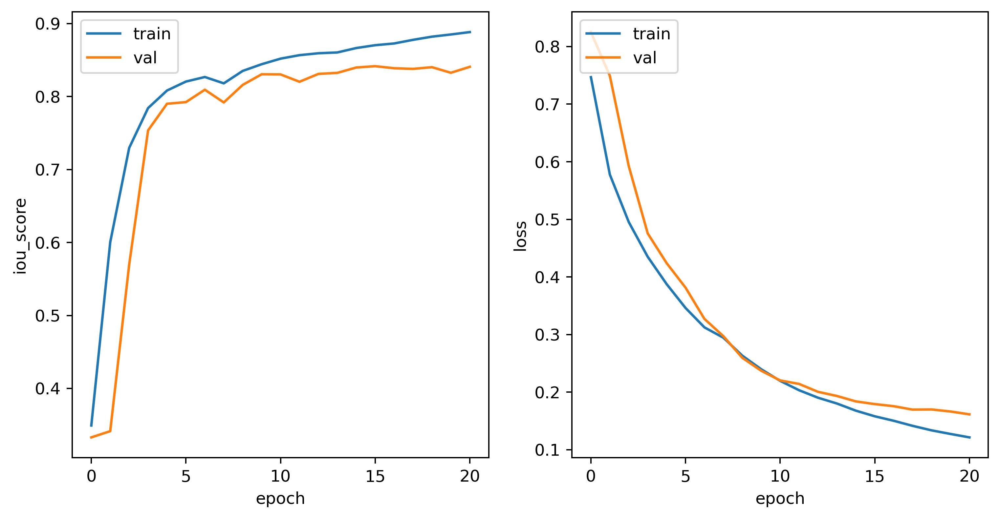

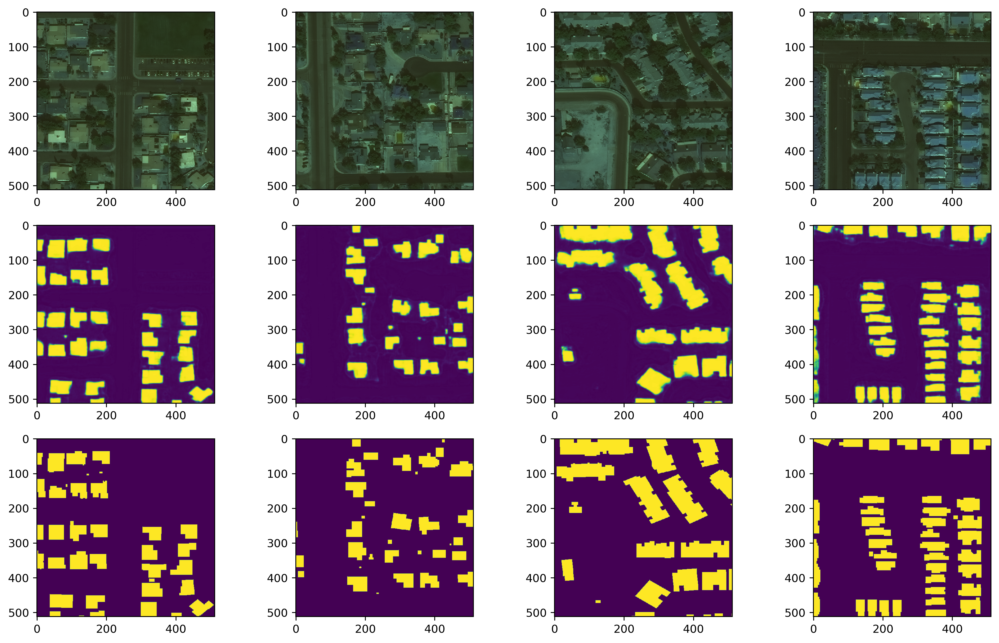

In [50]:
model.save(save_path + BACKBONE + "_" + model_name + '_model' + ".h5")

results = model.evaluate(test_generator)
print("test loss, test acc:", results)

plot_history(history)
plt.savefig(save_path +  BACKBONE + "_" + model_name + '_epoch_chart'+ ".png",bbox_inches='tight')


val_check =  model.predict(test_generator[1][0])

fig, axes = plt.subplots(3, 4, dpi=360, figsize=(16, 10))
# fig.subplots_adjust(hspace=0.1)

for a in np.arange(0,4):
    
    image = test_generator[1][0][a + 5 , :,:,:]
    
    ground_truth = test_generator[1][1][a + 5 , :,:,:]

    # Load masks
    mask = val_check[a+5,:,:,:]
    
    
    axes[0, a].imshow( image)
    axes[1, a].imshow( mask)
    axes[2, a].imshow( ground_truth)
    
plt.savefig(save_path +  BACKBONE + "_" + model_name + '_example_chart'+ ".png",bbox_inches='tight')



In [4]:
tf.keras.backend.clear_session()


BACKBONE = 'vgg16'
# BACKBONE = 'resnet50'
# BACKBONE = 'efficientnetb6'
# model_name = 'Unet'
model_name = 'Linknet'
BATCH_SIZE = 32
LR = 0.0001
EPOCHS = 50

n_classes = 1  # case for binary and multiclass segmentation
activation = 'sigmoid' if n_classes == 1 else 'softmax'

#create model

with mirrored_strategy.scope():
    if model_name == 'Unet':
        print(model_name)
        model = sm.Unet(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    elif model_name == 'Linknet':
        print(model_name)
        model = sm.Linknet(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    elif model_name == 'FPN':
        print(model_name)
        model = sm.FPN(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    

# define optomizer
optim = keras.optimizers.Adam(LR)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, total_loss, metrics)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(save_path + BACKBONE + "_" + model_name + ".h5",
                                    monitor='val_iou_score', 
                                    save_best_only=True, 
                                    mode='max'),
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.EarlyStopping(monitor='val_iou_score',
                           patience=5,
                           restore_best_weights=True,
                           mode='max')
]



Linknet
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorflow:Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
INFO:tensorf

In [7]:
start = datetime.now()

print("Model Fit")


history = model.fit(
    train_generator, 
    steps_per_epoch=len(train_generator), 
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=val_generator, 
    validation_steps=len(val_generator)
)


end = datetime.now()
print("\nTime Taken for testing: %s" % (end-start))

Model Fit
Epoch 1/50
Instructions for updating:
Use `tf.data.Iterator.get_next_as_optional()` instead.
INFO:tensorflow:batch_all_reduce: 79 all-reduces with algorithm = nccl, num_packs = 1
INFO:tensorflow:batch_all_reduce: 79 all-reduces with algorithm = nccl, num_packs = 1
35/35 [==============================] - 60s 2s/step - loss: 0.7151 - iou_score: 0.3818 - f1-score: 0.5442 - val_loss: 1.6660 - val_iou_score: 0.2075 - val_f1-score: 0.3433
Epoch 2/50
35/35 [==============================] - 60s 2s/step - loss: 0.5277 - iou_score: 0.6251 - f1-score: 0.7678 - val_loss: 0.5474 - val_iou_score: 0.5768 - val_f1-score: 0.7313
Epoch 3/50
35/35 [==============================] - 57s 2s/step - loss: 0.4347 - iou_score: 0.7310 - f1-score: 0.8443 - val_loss: 0.4820 - val_iou_score: 0.7001 - val_f1-score: 0.8233
Epoch 4/50
35/35 [==============================] - 55s 2s/step - loss: 0.3758 - iou_score: 0.7745 - f1-score: 0.8727 - val_loss: 0.4315 - val_iou_score: 0.7340 - val_f1-score: 0.8463


6/6 [==============================] - 2s 329ms/step - loss: 0.1622 - iou_score: 0.8374 - f1-score: 0.9114
test loss, test acc: [0.16221529245376587, 0.8373691439628601, 0.9114179611206055]


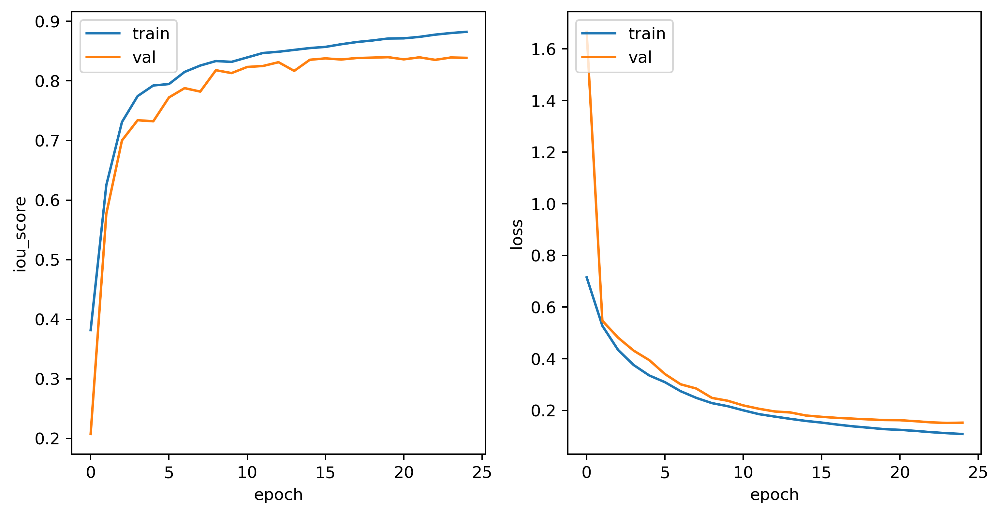

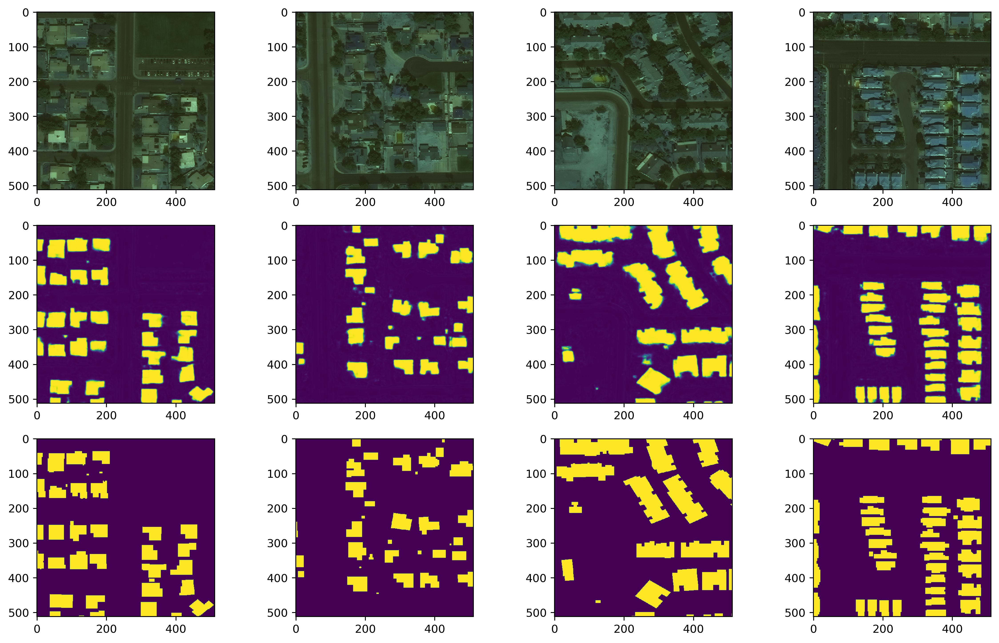

In [44]:
model.save(save_path + BACKBONE + "_" + model_name + '_model' + ".h5")

results = model.evaluate(test_generator)
print("test loss, test acc:", results)

plot_history(history)
plt.savefig(save_path +  BACKBONE + "_" + model_name + '_epoch_chart'+ ".png",bbox_inches='tight')


val_check =  model.predict(test_generator[1][0])

fig, axes = plt.subplots(3, 4, dpi=360, figsize=(16, 10))
# fig.subplots_adjust(hspace=0.1)

for a in np.arange(0,4):
    
    image = test_generator[1][0][a + 5 , :,:,:]
    
    ground_truth = test_generator[1][1][a + 5 , :,:,:]

    # Load masks
    mask = val_check[a+5,:,:,:]
    
    
    axes[0, a].imshow( image)
    axes[1, a].imshow( mask)
    axes[2, a].imshow( ground_truth)
    
plt.savefig(save_path +  BACKBONE + "_" + model_name + '_example_chart'+ ".png",bbox_inches='tight')



In [45]:
tf.keras.backend.clear_session()


BACKBONE = 'vgg16'
# BACKBONE = 'resnet50'
# BACKBONE = 'efficientnetb6'
# model_name = 'Unet'
# model_name = 'Linknet'
model_name = 'FPN'
BATCH_SIZE = 32
LR = 0.0001
EPOCHS = 50

n_classes = 1  # case for binary and multiclass segmentation
activation = 'sigmoid' if n_classes == 1 else 'softmax'

#create model

with mirrored_strategy.scope():
    if model_name == 'Unet':
        print(model_name)
        model = sm.Unet(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    elif model_name == 'Linknet':
        print(model_name)
        model = sm.Linknet(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    elif model_name == 'FPN':
        print(model_name)
        model = sm.FPN(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    

# define optomizer
optim = keras.optimizers.Adam(LR)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, total_loss, metrics)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(save_path + BACKBONE + "_" + model_name + ".h5",
                                    monitor='val_iou_score', 
                                    save_best_only=True, 
                                    mode='max'),
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.EarlyStopping(monitor='val_iou_score',
                           patience=5,
                           restore_best_weights=True,
                           mode='max')
]



FPN


In [46]:
start = datetime.now()

print("Model Fit")


history = model.fit(
    train_generator, 
    steps_per_epoch=len(train_generator), 
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=val_generator, 
    validation_steps=len(val_generator)
)


end = datetime.now()
print("\nTime Taken for testing: %s" % (end-start))

Model Fit
Epoch 1/50
INFO:tensorflow:batch_all_reduce: 65 all-reduces with algorithm = nccl, num_packs = 1
INFO:tensorflow:batch_all_reduce: 65 all-reduces with algorithm = nccl, num_packs = 1
35/35 [==============================] - 81s 2s/step - loss: 0.4643 - iou_score: 0.6055 - f1-score: 0.7435 - val_loss: 1.0898 - val_iou_score: 0.3136 - val_f1-score: 0.4763
Epoch 2/50
35/35 [==============================] - 80s 2s/step - loss: 0.2430 - iou_score: 0.7580 - f1-score: 0.8621 - val_loss: 0.4316 - val_iou_score: 0.7216 - val_f1-score: 0.8379
Epoch 3/50
35/35 [==============================] - 79s 2s/step - loss: 0.1948 - iou_score: 0.7931 - f1-score: 0.8845 - val_loss: 0.2818 - val_iou_score: 0.7920 - val_f1-score: 0.8838
Epoch 4/50
35/35 [==============================] - 80s 2s/step - loss: 0.1733 - iou_score: 0.8090 - f1-score: 0.8943 - val_loss: 0.2055 - val_iou_score: 0.8077 - val_f1-score: 0.8934
Epoch 5/50
35/35 [==============================] - 80s 2s/step - loss: 0.1567 - i

6/6 [==============================] - 3s 463ms/step - loss: 0.1446 - iou_score: 0.8330 - f1-score: 0.9088
test loss, test acc: [0.14455090463161469, 0.8330386281013489, 0.9087865352630615]


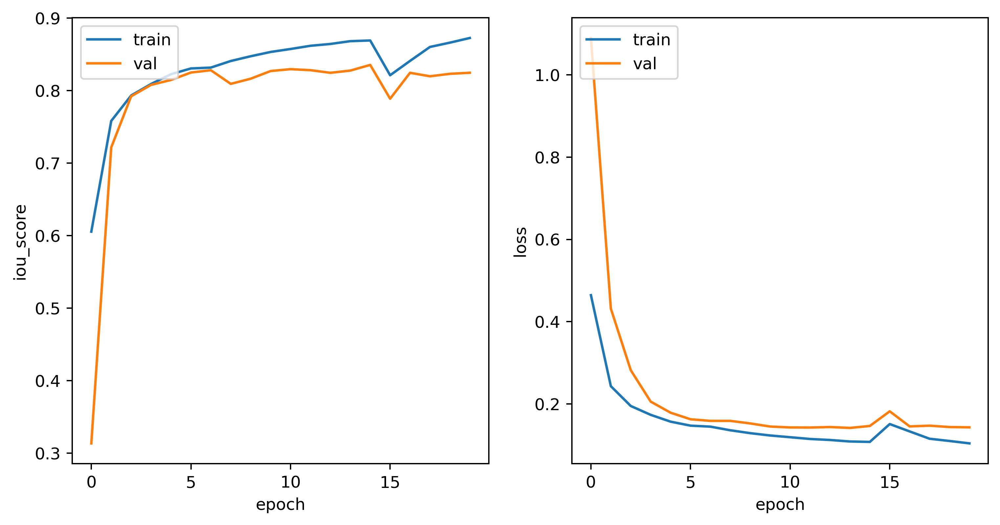

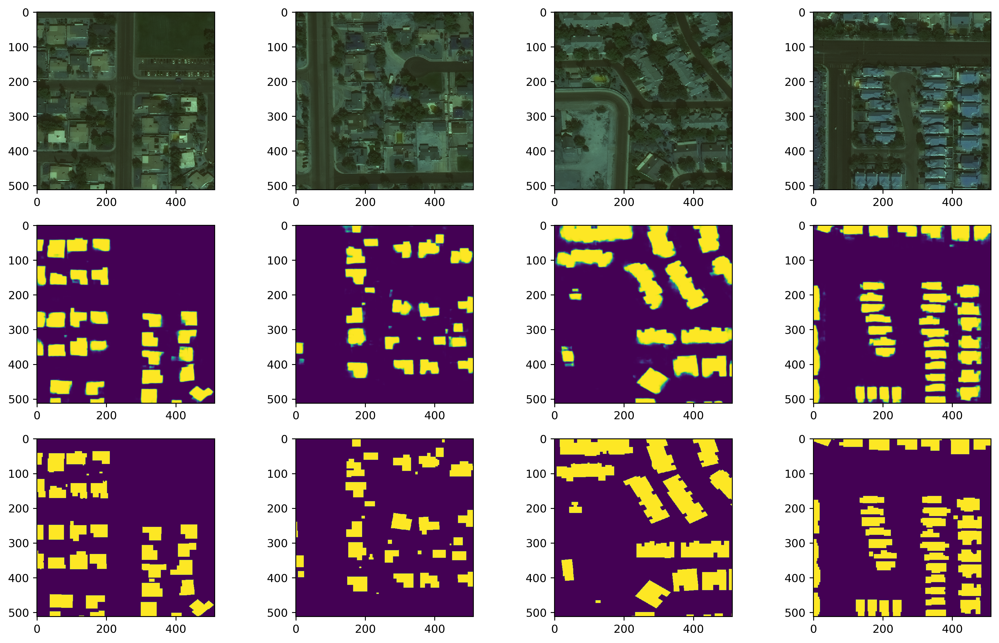

In [47]:
model.save(save_path + BACKBONE + "_" + model_name + '_model' + ".h5")

results = model.evaluate(test_generator)
print("test loss, test acc:", results)

plot_history(history)
plt.savefig(save_path +  BACKBONE + "_" + model_name + '_epoch_chart'+ ".png",bbox_inches='tight')


val_check =  model.predict(test_generator[1][0])

fig, axes = plt.subplots(3, 4, dpi=360, figsize=(16, 10))
# fig.subplots_adjust(hspace=0.1)

for a in np.arange(0,4):
    
    image = test_generator[1][0][a + 5 , :,:,:]
    
    ground_truth = test_generator[1][1][a + 5 , :,:,:]

    # Load masks
    mask = val_check[a+5,:,:,:]
    
    
    axes[0, a].imshow( image)
    axes[1, a].imshow( mask)
    axes[2, a].imshow( ground_truth)
    
plt.savefig(save_path +  BACKBONE + "_" + model_name + '_example_chart'+ ".png",bbox_inches='tight')



In [9]:
tf.keras.backend.clear_session()


# BACKBONE = 'vgg16'
# BACKBONE = 'resnet50'
BACKBONE = 'efficientnetb3'

model_name = 'Unet'
# model_name = 'Linknet'
# model_name = 'FPN'
BATCH_SIZE = 32
LR = 0.0001
EPOCHS = 50

n_classes = 1  # case for binary and multiclass segmentation
activation = 'sigmoid' if n_classes == 1 else 'softmax'

#create model

with mirrored_strategy.scope():
    if model_name == 'Unet':
        print(model_name)
        model = sm.Unet(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    elif model_name == 'Linknet':
        print(model_name)
        model = sm.Linknet(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    elif model_name == 'FPN':
        print(model_name)
        model = sm.FPN(BACKBONE,classes=n_classes,input_shape=(512, 512, 3), activation=activation)
    

# define optomizer
optim = keras.optimizers.Adam(LR)

# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 

metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, total_loss, metrics)

# define callbacks for learning rate scheduling and best checkpoints saving
callbacks = [
    keras.callbacks.ModelCheckpoint(save_path + BACKBONE + "_" + model_name + ".h5",
                                    monitor='val_iou_score', 
                                    save_best_only=True, 
                                    mode='max'),
    keras.callbacks.ReduceLROnPlateau(),
    keras.callbacks.EarlyStopping(monitor='val_iou_score',
                           patience=5,
                           restore_best_weights=True,
                           mode='max')
]



Unet
44113920/44107200 [==============================] - 0s 0us/step


In [10]:
start = datetime.now()

print("Model Fit")


history = model.fit(
    train_generator, 
    steps_per_epoch=len(train_generator), 
    epochs=EPOCHS, 
    callbacks=callbacks, 
    validation_data=val_generator, 
    validation_steps=len(val_generator)
)


end = datetime.now()
print("\nTime Taken for testing: %s" % (end-start))

Model Fit
Epoch 1/50
INFO:tensorflow:batch_all_reduce: 370 all-reduces with algorithm = nccl, num_packs = 1
INFO:tensorflow:batch_all_reduce: 370 all-reduces with algorithm = nccl, num_packs = 1
35/35 [==============================] - 93s 3s/step - loss: 0.7498 - iou_score: 0.3270 - f1-score: 0.4831 - val_loss: 0.9433 - val_iou_score: 0.2014 - val_f1-score: 0.3344
Epoch 2/50
35/35 [==============================] - 86s 2s/step - loss: 0.5416 - iou_score: 0.6071 - f1-score: 0.7530 - val_loss: 0.7395 - val_iou_score: 0.3389 - val_f1-score: 0.5051
Epoch 3/50
35/35 [==============================] - 83s 2s/step - loss: 0.4281 - iou_score: 0.7449 - f1-score: 0.8532 - val_loss: 0.6341 - val_iou_score: 0.5451 - val_f1-score: 0.7049
Epoch 4/50
35/35 [==============================] - 81s 2s/step - loss: 0.3632 - iou_score: 0.7934 - f1-score: 0.8846 - val_loss: 0.5713 - val_iou_score: 0.5380 - val_f1-score: 0.6981
Epoch 5/50
35/35 [==============================] - 81s 2s/step - loss: 0.3178 -

6/6 [==============================] - 2s 336ms/step - loss: 0.1681 - iou_score: 0.8256 - f1-score: 0.9043
test loss, test acc: [0.16810797154903412, 0.8256287574768066, 0.9042986035346985]


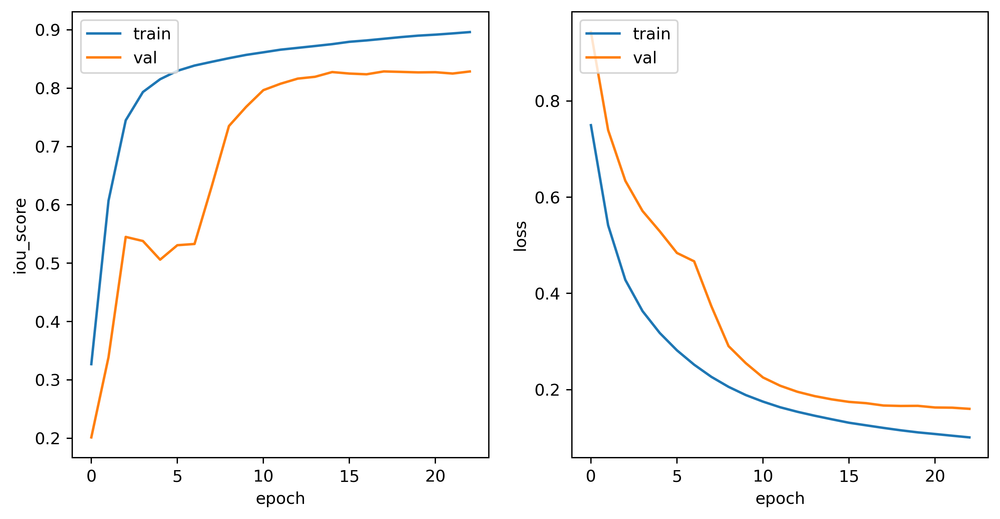

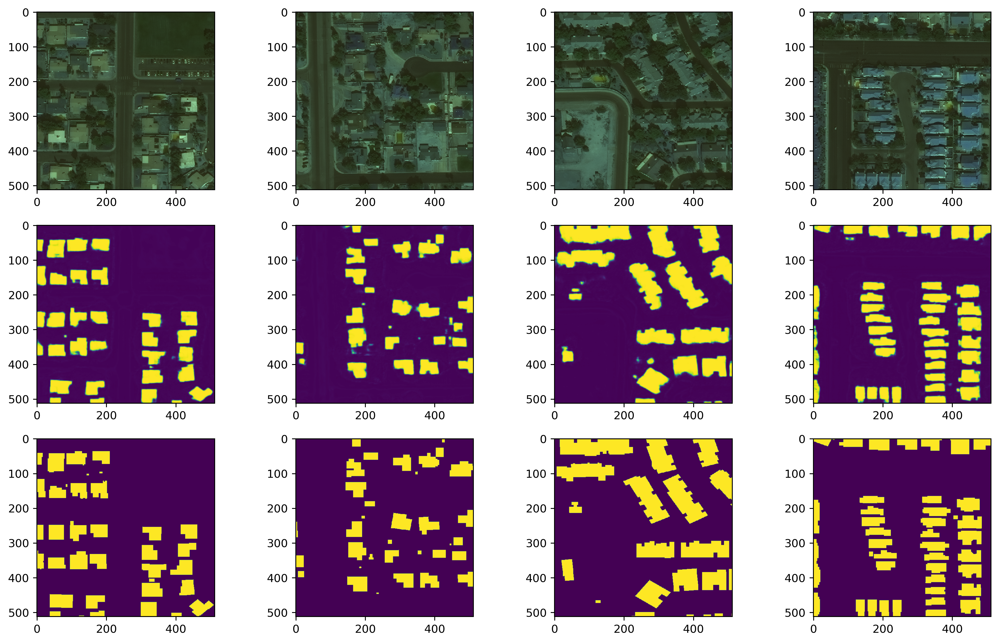

In [11]:
model.save(save_path + BACKBONE + "_" + model_name + '_model' + ".h5")

results = model.evaluate(test_generator)
print("test loss, test acc:", results)

plot_history(history)
plt.savefig(save_path +  BACKBONE + "_" + model_name + '_epoch_chart'+ ".png",bbox_inches='tight')


val_check =  model.predict(test_generator[1][0])

fig, axes = plt.subplots(3, 4, dpi=360, figsize=(16, 10))
# fig.subplots_adjust(hspace=0.1)

for a in np.arange(0,4):
    
    image = test_generator[1][0][a + 5 , :,:,:]
    
    ground_truth = test_generator[1][1][a + 5 , :,:,:]

    # Load masks
    mask = val_check[a+5,:,:,:]
    
    
    axes[0, a].imshow( image)
    axes[1, a].imshow( mask)
    axes[2, a].imshow( ground_truth)
    
plt.savefig(save_path +  BACKBONE + "_" + model_name + '_example_chart'+ ".png",bbox_inches='tight')

